# Final Model

In this notebook, I present the final results.

In the end, I concluded that finding Waldo on a *Where's Waldo* map, is an uniquely difficult problem when it comes to object detection. Each map has a unique art style and size. Not to mention that Waldo looks different in every example. As such, the only way to create a decent model was to provide it with prior knowledge about the maps and where Waldo could be found in each map. With this, the model was able to achieve about 75% mIoU, which does not sound too great, but the results are actually quite good.

In [1]:
import IPython.core.display as di
from IPython.display import Markdown as md

def toggle_code():
    di.display_html(
        """<button onclick="jQuery('.input_area').toggle();jQuery('.prompt').toggle();">
            Toggle code
        </button>""",
        raw=True,
    )
    
def md_cat(file_path):
    with open(file_path) as file:
        return md(f"```python\n{file.read()}\n```")

toggle_code()

Toggle code

In [2]:
import os
import sys

import matplotlib.pyplot as plt
import numpy as np
import torch
import torchvision as torchv
from matplotlib import patches
from PIL import Image

In [3]:
data_path = "../data"
sys.path.append(data_path)

In [4]:
from Dataset import TestDataset, originals
from WaldoNet import WaldoNet

In [5]:
dataset = TestDataset()
test_dataloader = torch.utils.data.DataLoader(
    TestDataset(),
    batch_size  = 1,
    num_workers = 1,
    shuffle     = False,
    drop_last   = False
)

S = 16
bounding_box_max_width = np.max([d[1][2] for d in dataset.data])
bounding_box_min_width = np.min([d[1][2] for d in dataset.data])
bounding_box_max_height = np.max([d[1][3] for d in dataset.data])
bounding_box_min_height = np.min([d[1][3] for d in dataset.data])

## Model Definition

In [6]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

def to_device(tensor):
    return tensor.to(device)

In [7]:
class FinalModel(torch.nn.Module):
    
    def __init__(self, load_path):
        super().__init__()
        
        self.waldonet = WaldoNet()
        self.locale_block = torch.nn.Sequential(
            torch.nn.Linear(500, S*S, bias=False),
        )
            
        self.bounds_block = torch.nn.Sequential(
            torch.nn.Linear(500, 128, bias=False),
            torch.nn.ReLU(inplace=True),
            torch.nn.Linear(128, 4, bias=False),
        )
        
        self.load(load_path)
        
    def forward(self, x):
        x = self.waldonet(x)
        
        locale_probs = self.locale_block(x)
        bounds_probs = self.bounds_block(x)
        bounds_probs = torch.sigmoid(bounds_probs)
        return locale_probs, bounds_probs
    
    def __call__(self, x):
        return self.forward(x)
    
    def num_params(self):
        return sum([p.numel() for p in self.parameters() if p.requires_grad])
            
    def load(self, load_path, strict=False):
        self.load_state_dict(torch.load(load_path), strict=strict)
            
    def save(self, save_path):
        torch.save(self.state_dict(), save_path)

In [8]:
model = FinalModel(".checkpoints/final_model.pt")
model = to_device(model)

for p in model.parameters():
    p.requires_grad = False

## Results

In [9]:
def extract_prediction_box(images, locale, bounds):
    i = locale // (S - 1)
    j = locale % (S - 1)

    n, image_c, image_h, image_w = images.shape
    t_x, t_y, t_w, t_h = bounds[0]
    S_w = int(image_w // (S - 1))
    S_h = int(image_h // (S - 1))
    b_w = int(bounding_box_max_width * t_w + bounding_box_min_width)
    b_h = int(bounding_box_max_height * t_h + bounding_box_min_height)
    b_x = int((t_x + i) * S_w - b_w // 2)
    b_y = int((t_y + j) * S_h - b_h // 2)
    return b_x, b_y, b_w, b_h

In [10]:
%%time

with torch.no_grad():
    bounds = []
    for images, label in test_dataloader:
        images = to_device(images)
        locale_probs, bounds_pred = model.forward(images)
        locale_pred = locale_probs.argmax().item()
        bounds_pred = bounds_pred.cpu().detach().numpy()

        bounds.append(extract_prediction_box(images, locale_pred, bounds_pred))
        
    torch.cuda.empty_cache()

CPU times: user 1.09 s, sys: 176 ms, total: 1.27 s
Wall time: 1.36 s


Notice that it took less than 2 seconds for the model to find Waldo in all of the example maps. Here is what it found:

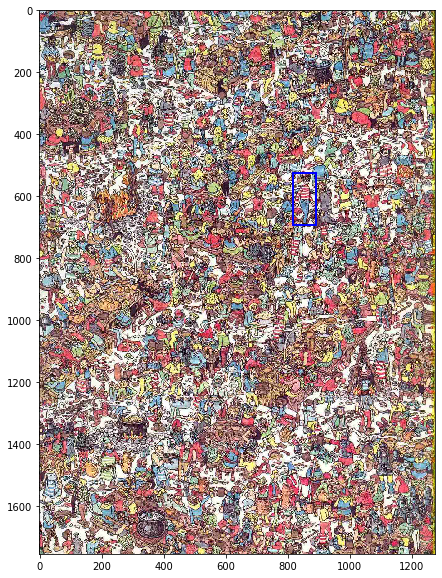

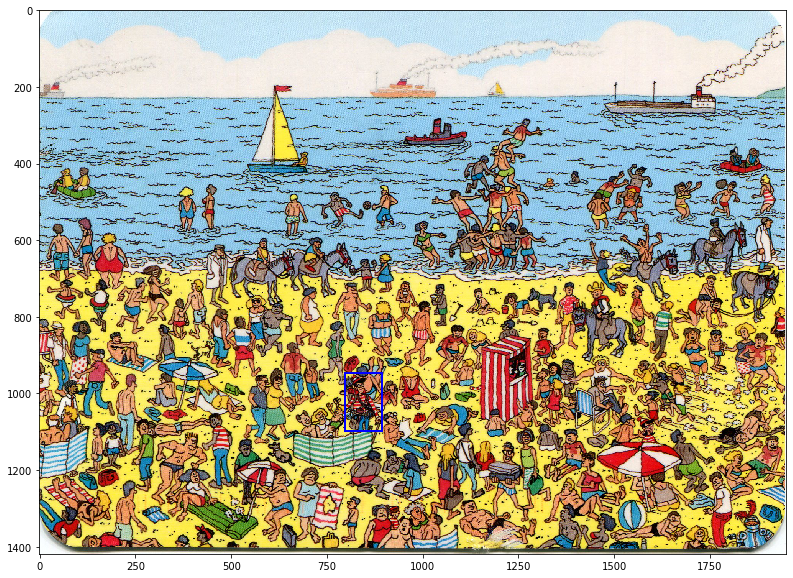

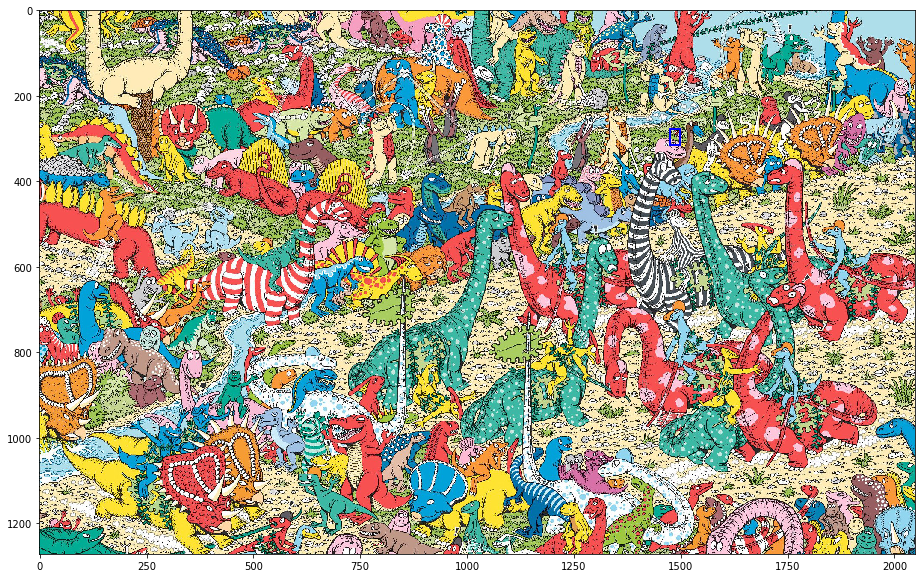

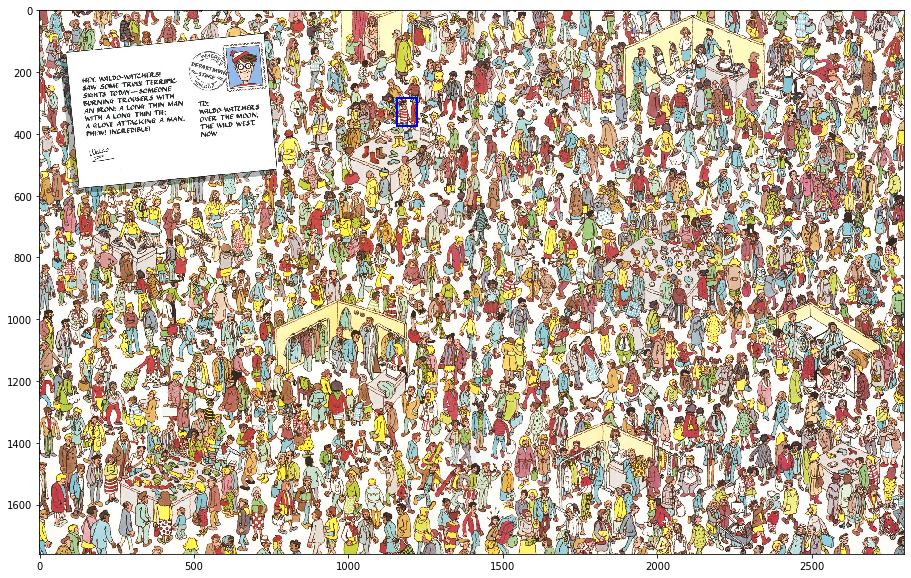

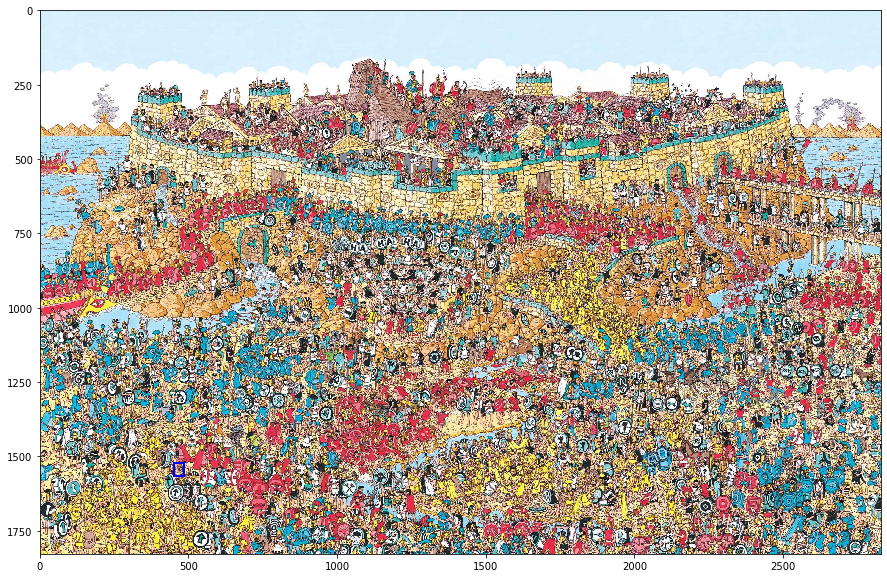

...

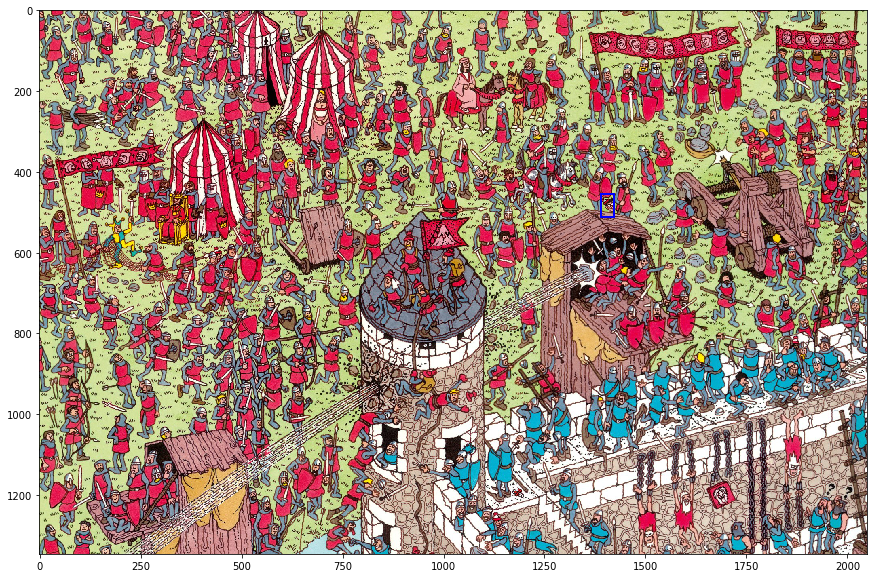

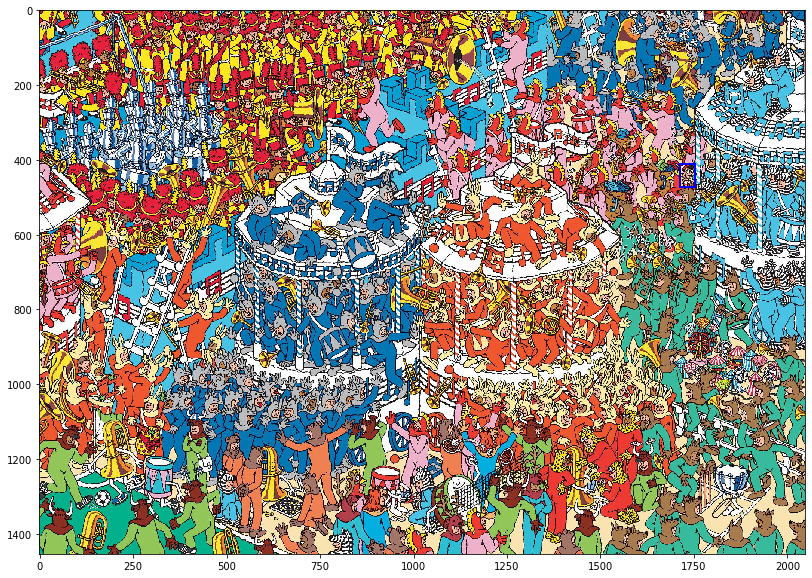

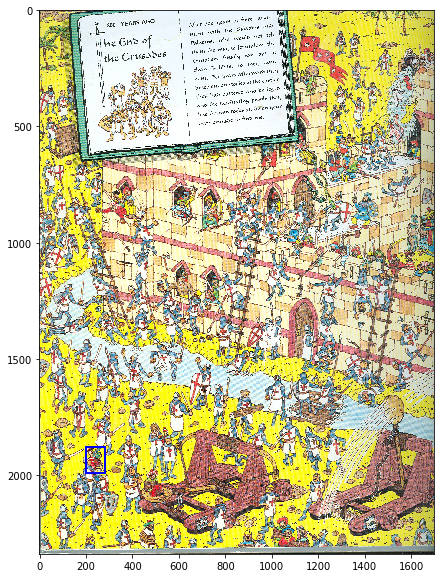

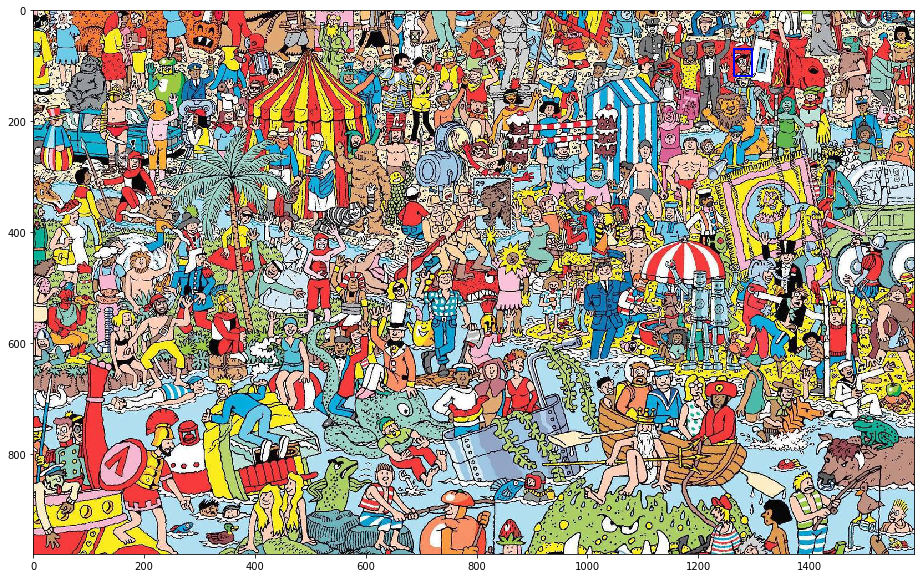

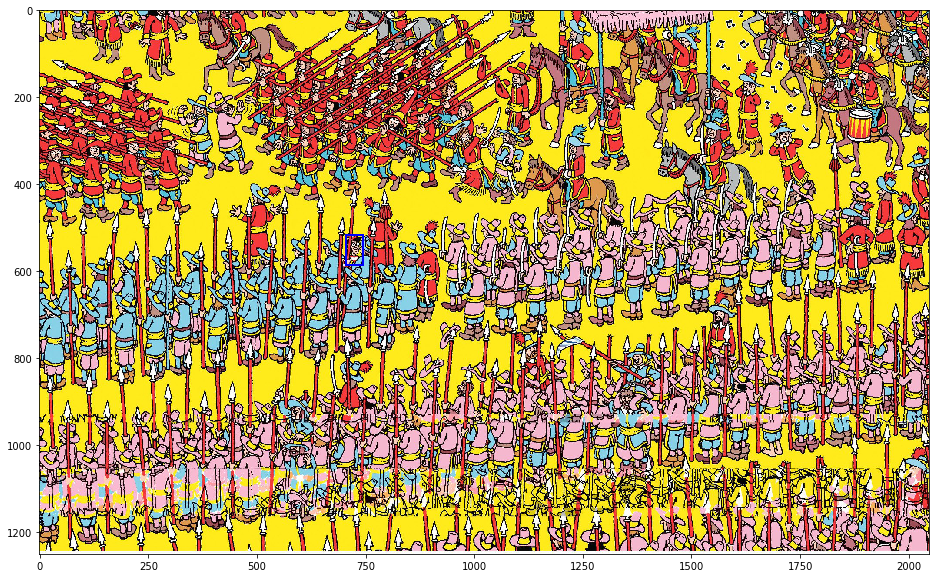

In [11]:
for (images, label), (b_x, b_y, b_w, b_h) in zip(test_dataloader, bounds):
    waldo_map = images.detach().numpy()
    waldo_map = np.moveaxis(np.squeeze(waldo_map, axis=0), 0, -1)

    fig, ax = plt.subplots(1, figsize=(18, 10))
    ax.imshow(waldo_map)
    ax.add_patch(patches.Rectangle((b_x, b_y), b_w, b_h, linewidth=2, edgecolor='b', facecolor='none'))
#     x, y, w, h = labels.numpy()[0]  # Ground Truth
#     ax.add_patch(patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none'))
    plt.show()

Note that the example maps are all in-sample and thus can be expected to perform well.

## Out-of-Sample Example

In [12]:
out_of_sample_dataloader = torch.utils.data.DataLoader(
    [torchv.transforms.ToTensor()(np.array(Image.open("../data/data/original-images/16.jpg")))],
    batch_size  = 1,
    num_workers = 1,
    shuffle     = False,
    drop_last   = False
)

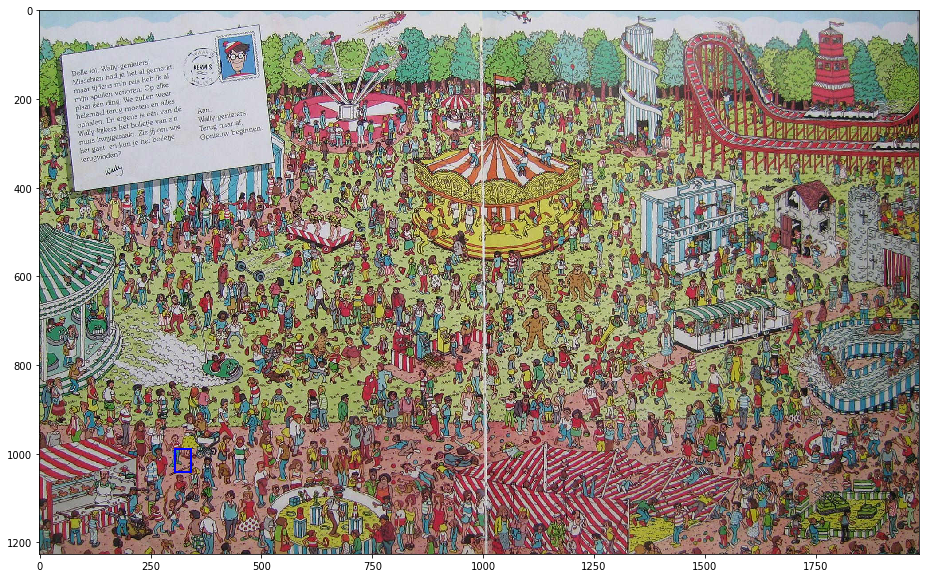

In [13]:
images = next(iter(out_of_sample_dataloader))
images = to_device(images)
locale_probs, bounds_pred = model.forward(images)
locale_pred = locale_probs.argmax().item()
bounds_pred = bounds_pred.cpu().detach().numpy()

b_x, b_y, b_w, b_h = extract_prediction_box(images, locale_pred, bounds_pred)

waldo_map = images.cpu().detach().numpy()
waldo_map = np.moveaxis(np.squeeze(waldo_map, axis=0), 0, -1)
    
fig, ax = plt.subplots(1, figsize=(18, 10))
ax.imshow(waldo_map)
ax.add_patch(patches.Rectangle((b_x, b_y), b_w, b_h, linewidth=2, edgecolor='b', facecolor='none'))

plt.show()

Clearly, the model was unable to find Waldo in this out-of-sample image. However, this is expected as this map (that the model has never seen before) has an artstyle that is unlike any of the other maps. The map is also very large and the quality is not the greatest.